<center><a target="_blank" href="https://learning.constructor.org/"><img src="https://drive.google.com/uc?id=1wxkbM60NlBlkbGK1JqUypKL24RrTiiYk" width="200" style="background:none; border:none; box-shadow:none;" /></a> </center>

_____

<center> <h1> Plotly Exercises </h1> </center>

<p style="margin-bottom:1cm;"></p>

_____

<center>Constructor Learning, 2023</center>


This notebook contains several Plotly exercises to get used with that library.

## Table of contents

* Exercise 1.1: Subplots
* Exercise 1.2: Scatter plots
* Exercise 1.3: Maps with GeoJSON

## Import dependencies

In [1]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd

## Exercise 1.1: Subplots

* Create a subplot with two rows, and two columns in the first row, but just one column in the second (bottom) row.
* In the top left, plot a boxplot comparing tips distribution for category smoker.
* In the top right, plot a scatter plot with the total bill in the x-axis and the tip in the y-axis.
* In the bottom, plot a bar chart with the total bills (y-axis) per day (x-axis). Use a trace per `sex`.

### Help

* [Subplots](https://plotly.com/python/subplots/)
* [Box plots](https://plotly.com/python/box-plots/)
* [Scatter plots](https://plotly.com/python/line-and-scatter/)
* [Bar charts](https://plotly.com/python/bar-charts/)

### Dataset

The dataset is presented bellow. It is a dataframe with records for bills and tips in a restaurant for several days and types of clients.

In [2]:
ds_e1 = px.data.tips()
ds_e1.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


### Solution 1.1

In [3]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(
    rows=2, cols=2,
    specs=[[{}, {}],
           [{"colspan": 2}, None]],
    subplot_titles=(
        "Tip distribution Smokers vs Non smokers",
        "Tip vs Total bill in USD", 
        "Bills amount per day and sex"
    )
)
fig.update_layout(height=800)


# Top left a box plot
fig.add_traces(
    data=[
        go.Box(y=ds_e1[ds_e1['smoker']=="No"]['tip'], name="Non Smoker"),
        go.Box(y=ds_e1[ds_e1['smoker']=='Yes']['tip'], name="Smoker")
    ], rows=[1, 1], cols=[1, 1]
)
fig.update_yaxes({'title': 'Tips'}, row=1, col=1)


# Top right scatter plot
fig.add_trace(
    go.Scatter(x=ds_e1['total_bill'], y=ds_e1['tip'], mode="markers", name="Tips"),
    row=1, col=2,
)

fig.update_xaxes({"title": "Total bill"}, row=1, col=2)
fig.update_yaxes({"title": "Tips"}, row=1, col=2)

# Bottom chart bar charts per day.
ds_e1_agg = ds_e1[['sex', 'total_bill', 'day']].groupby(['sex', 'day']).agg('sum').reset_index()
fig.add_traces(
    data=[
        go.Bar(y=ds_e1_agg[ds_e1_agg['sex']=='Female']['total_bill'], x=ds_e1_agg[ds_e1_agg['sex']=="Female"]['day'], name="Female"),
        go.Bar(y=ds_e1_agg[ds_e1_agg['sex']=='Male']['total_bill'], x=ds_e1_agg[ds_e1_agg['sex']=="Male"]['day'], name="Male"),
    ],
    rows=[2, 2], cols=[1, 1]
)
fig.update_xaxes({'title': 'Day of the week'}, row=2, col=1)
fig.update_yaxes({'title': 'Total bill'}, row=2, col=1)

fig.show()

## Exercise 1.2: Scatter plots

For the iris dataset let's plot a scater plot as follows:

* Sepal length in the `x`axis and sepal width in the `y`axis. 
* The area of the bubbles must be proportional to the petal's length.
* Add a trace per species.
* Marker's shape should be `square`.
* Modify the hover template so all information is displayed together.
* Change color background for the chart and the whole plot.
* Add title, and `x` and `y` labels with font size 18.

### Help

* [Scatter plots](https://plotly.com/python/line-and-scatter/)
* [Hover](https://plotly.com/python/hover-text-and-formatting/)
* [Axis](https://plotly.com/python/figure-labels/)

### Dataset

The dataset presented bellow consists of records of different species of flowers with records for different characteristics.

In [4]:
ds_e2 = px.data.iris()
ds_e2.head()

,sepal_length,sepal_width,petal_length,petal_width,species,species_id
0,5.1,3.5,1.4,0.2,setosa,1
1,4.9,3.0,1.4,0.2,setosa,1
2,4.7,3.2,1.3,0.2,setosa,1
3,4.6,3.1,1.5,0.2,setosa,1
4,5.0,3.6,1.4,0.2,setosa,1


### Solution 1.2

In [5]:
species = ds_e2['species'].unique()


fig = go.Figure()

for s in species:
    df_s = ds_e2[ds_e2['species']==s]
    fig.add_trace(
        go.Scatter(
            x=df_s['sepal_length'], y=df_s['sepal_width'], 
            mode="markers",
            name=s.capitalize(),
            text=df_s['species'],
            marker={
                "symbol": "square",
                "sizemode": "area", 
                "size": df_s['petal_length'], 
                "sizeref": max(ds_e2['petal_length'])*0.01
            },
            hovertemplate="<b>%{text}</b><br><br>" +
            "Sepal width: %{x:.1f}<br>" + 
            "Sepal length: %{y:.1f}<br>" +
            "Petal length: %{marker.size:.1f}<br>" +
            "<extra></extra>"
        )
    )
    
fig.update_layout(
    title="Iris Dataset",
    xaxis={"title": {"text": "Sepal length", "font_size": 18}}, # Note you can specify the size using font_size key
    yaxis={"title": {"text": "Sepal width", "font": {"size": 18}}}, # Or you can create a dictionnary if you want to add more font properties
    height=600,
    plot_bgcolor="rgb(240, 250, 240)",
    paper_bgcolor="rgb(240, 250, 240)"
)
    
fig.show()

## Exercise 1.3: Maps

In this last exercise we will use a GeoJSON object to plot polygons on a Map. We will come back to the elections dataset used before.

* Use Choropleth mapbox to plot the polygons in the GeoJson object.
* Color each district or polygon according to the winner.

### Help

* [Maps](https://plotly.com/python/maps/)
* [Plotly Express](https://plotly.com/python/plotly-express/)

### Dataset

The dataset consists of a GeoJSON object, containing the polygons defining the shape of each district. There is also a dataset contaning the elections results for each district.

In [6]:
geojson = px.data.election_geojson()
ds = px.data.election()

In [7]:
ds

,district,Coderre,Bergeron,Joly,total,winner,result,district_id
0,101-Bois-de-Liesse,2481,1829,3024,7334,Joly,plurality,101
1,102-Cap-Saint-Jacques,2525,1163,2675,6363,Joly,plurality,102
2,11-Sault-au-Récollet,3348,2770,2532,8650,Coderre,plurality,11
3,111-Mile-End,1734,4782,2514,9030,Bergeron,majority,111
4,112-DeLorimier,1770,5933,3044,10747,Bergeron,majority,112
5,113-Jeanne-Mance,1455,3599,2316,7370,Bergeron,plurality,113
6,12-Saint-Sulpice,3252,2521,2543,8316,Coderre,plurality,12
7,121-La Pointe-aux-Prairies,5456,1760,3330,10546,Coderre,majority,121
8,122-Pointe-aux-Trembles,4734,1879,2852,9465,Coderre,majority,122
9,123-Rivière-des-Prairies,5737,958,1656,8351,Coderre,majority,123


In [10]:
geojson

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-73.6363215300962, 45.5759177646435],
       [-73.6362833815582, 45.5758266113331],
       [-73.6446417578686, 45.5658132919643],
       [-73.6453511352974, 45.5647725775888],
       [-73.648867564748, 45.5586898267402],
       [-73.6513170845065, 45.5545659435652],
       [-73.6515658357324, 45.5554439857955],
       [-73.6660837831645, 45.5596724837829],
       [-73.6706609041685, 45.5610978251999],
       [-73.6676019919116, 45.5632340862888],
       [-73.6645385824068, 45.5642716484367],
       [-73.663663123697, 45.5654269638586],
       [-73.663336397858, 45.5666288247853],
       [-73.6637764768649, 45.5678900619231],
       [-73.6625073244826, 45.5688479494114],
       [-73.6624620526633, 45.5708304456346],
       [-73.6620201425015, 45.5713925326191],
       [-73.6616100197742, 45.5737924780218],
       [-73.6612199500215, 45.5747171555678],
       [-7

### Solution 1.3

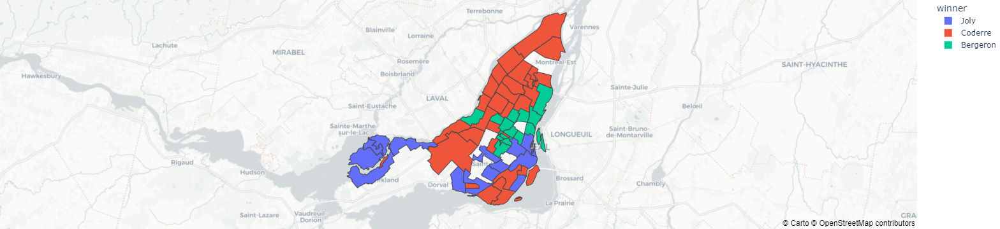

In [11]:
fig = px.choropleth_mapbox(
    ds, 
    geojson=geojson, 
    color="winner",
    locations="district", 
    featureidkey="properties.district",
    center={"lat": 45.5517, "lon": -73.7073},
    mapbox_style="carto-positron", 
    zoom=9
)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

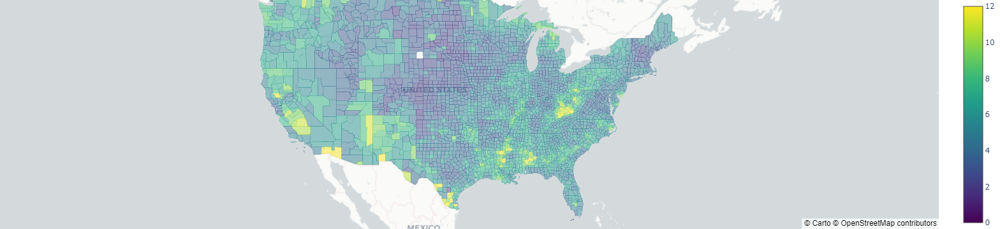

In [12]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.graph_objects as go

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=df.fips, z=df.unemp,
                                    colorscale="Viridis", zmin=0, zmax=12,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [13]:
counties

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'properties': {'GEO_ID': '0500000US01001',
    'STATE': '01',
    'COUNTY': '001',
    'NAME': 'Autauga',
    'LSAD': 'County',
    'CENSUSAREA': 594.436},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-86.496774, 32.344437],
      [-86.717897, 32.402814],
      [-86.814912, 32.340803],
      [-86.890581, 32.502974],
      [-86.917595, 32.664169],
      [-86.71339, 32.661732],
      [-86.714219, 32.705694],
      [-86.413116, 32.707386],
      [-86.411172, 32.409937],
      [-86.496774, 32.344437]]]},
   'id': '01001'},
  {'type': 'Feature',
   'properties': {'GEO_ID': '0500000US01009',
    'STATE': '01',
    'COUNTY': '009',
    'NAME': 'Blount',
    'LSAD': 'County',
    'CENSUSAREA': 644.776},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-86.577799, 33.765316],
      [-86.759144, 33.840617],
      [-86.953664, 33.815297],
      [-86.954305, 33.844862],
      [-86.96296, 33.844865],
      [-86.9

In [14]:
?go.Choroplethmapbox

Init signature:
go.Choroplethmapbox(
    arg=None,
    autocolorscale=None,
    below=None,
    coloraxis=None,
    colorbar=None,
    colorscale=None,
    customdata=None,
    customdatasrc=None,
    featureidkey=None,
    geojson=None,
    hoverinfo=None,
    hoverinfosrc=None,
    hoverlabel=None,
    hovertemplate=None,
    hovertemplatesrc=None,
    hovertext=None,
    hovertextsrc=None,
    ids=None,
    idssrc=None,
    legendgroup=None,
    locations=None,
    locationssrc=None,
    marker=None,
    meta=None,
    metasrc=None,
    name=None,
    reversescale=None,
    selected=None,
    selectedpoints=None,
    showlegend=None,
    showscale=None,
    stream=None,
    subplot=None,
    text=None,
    textsrc=None,
    uid=None,
    uirevision=None,
    unselected=None,
    visible=None,
    z=None,
    zauto=None,
    zmax=None,
    zmid=None,
    zmin=None,
    zsrc=None,
    **kwargs,
)
Docstring:     
Base class for the all trace types.

Specific trace type classes (Scatter

## Exercise 1.4: Advanced customization

In this final exercise you can start working on the plots for the visualization mini project. Tomorrow you will complete this project, and (optionally) push your code to GitHub and deploy it as a small web app online to showcase your work to others. 

To get started, have a look at the three datasets presented on the [Mini Project page](https://monolith.propulsion-home.ch/backend/api/momentum/materials/ds-materials/02_Visualization/day3/pages/mini_project_1.html) on Momentum and select the one that you're most interested in.


### Choropleth Map

- use ``px.choropleth_mapbox()`` to create a choropleth map showing the geographic features from the geoJSON file or just use ``px.choropleth()`` for a world map (geoJSON file not required).
- if necessary, adjust display options of your map, such as the center latitude and longitude, the zoom, size and margins
- once you're satisfied with the geographic features, add data to the map, showing some relevant information from your dataset
- adjust the hover tooltips to display meaningful information
- add a title and adjust the legend, if required
- choose a map style and color scale to your taste
- customize your map further as you like

**Note:** You'll get access to a wider range of customization options, if you [create a Mapbox Account](https://account.mapbox.com/auth/signup/) and use your mapbox access token in your plots. A credit card is required, but you will get up to 50'000 free map loads.


### Other Plot Types

- explore your dataset further and try out some more simple plot types (scatter, line, bar plots) to show different aspects of your data
- adjust the hover tooltips to display meaningful information
- add a title and adjust the legend, if required
- align the style with your choropleth map


### Bonus: 

If you're having fun and want to spend some more time on this: 

-  use categorical features from your dataset to create a [Sankey Diagram](https://plotly.com/python/sankey-diagram/) or a [Treemap](https://plotly.com/python/treemaps/)


### Help

* [Legend](https://plotly.com/python/legend/)
* [Axis](https://plotly.com/python/axes/)
* [Annotations](https://plotly.com/python/text-and-annotations/)
* [Ticks format](https://plotly.com/python/tick-formatting/)
* [D3 Format](https://github.com/d3/d3-format/blob/master/README.md#locale_format)


### Solution 1.4

### Dataset: Internet Access

In [16]:
# Read in the data - downloaded from here: https://data.worldbank.org/indicator/IT.NET.USER.ZS

internet_access_perc = pd.read_csv("../data/internet/share-of-individuals-using-the-internet.csv")
internet_access_perc.head()

,Entity,Code,Year,Individuals using the Internet (% of population)
0,Afghanistan,AFG,1990,0.0
1,Afghanistan,AFG,1991,0.0
2,Afghanistan,AFG,1992,0.0
3,Afghanistan,AFG,1993,0.0
4,Afghanistan,AFG,1994,0.0


In [17]:
# Select data from the most recent year for each country

countries = []
most_recent_year = []

for grp, df in internet_access_perc.groupby("Code"):
    countries.append(grp)
    most_recent_year.append(df["Year"].max())
    
recent_years_df = pd.DataFrame({"Code": countries, "most_recent_year": most_recent_year})

recent_perc = pd.merge(recent_years_df, internet_access_perc)
recent_perc = recent_perc[recent_perc["Year"]==recent_perc["most_recent_year"]]

recent_perc.head()

,Code,most_recent_year,Entity,Year,Individuals using the Internet (% of population)
25,ABW,2017,Aruba,2017,97.170000
47,AFG,2017,Afghanistan,2017,11.447688
75,AGO,2017,Angola,2017,14.339079
104,ALB,2019,Albania,2019,69.642855
131,AND,2017,Andorra,2017,91.567467


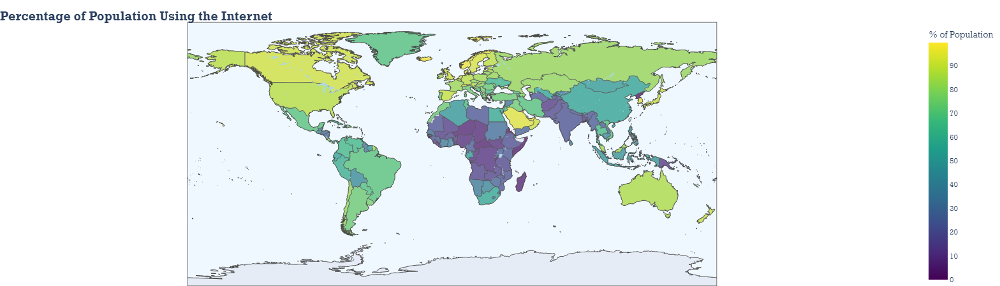

In [18]:
# Create the map, add hovertips, title, labels, styling, etc.

fig = px.choropleth(
    recent_perc,
    locations="Code", 
    color="Individuals using the Internet (% of population)",

    width=950,
    height=450,
    labels={"Individuals using the Internet (% of population)":"% of Population",
           "most_recent_year":"Year"},
    hover_name="Entity",
    hover_data={"Code": False,
                "most_recent_year":True,
                "Individuals using the Internet (% of population)":':.2f'},
    title="<b>Percentage of Population Using the Internet</b>",
    color_continuous_scale="Viridis",
    
)

fig.update_traces(marker={"opacity":0.7})

fig.update_layout(margin={"r":20,"t":35,"l":0,"b":0},
                  font_family="Rockwell",
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Rockwell"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0,
                        "yanchor":"top"},
                  geo={"resolution":50,
                      "showlakes":True, "lakecolor":"lightblue", 
                       "showocean":True, "oceancolor":"aliceblue"
                      }
                 )

fig.show()

### Dataset: Clean Energy Sources

In [19]:
# Data from: https://data.open-power-system-data.org/renewable_power_plants/
clean_energy_ch = pd.read_csv("../data/clean_energy/renewable_power_plants_CH.csv")
clean_energy_ch.head()

,electrical_capacity,energy_source_level_1,energy_source_level_2,energy_source_level_3,technology,data_source,nuts_1_region,nuts_2_region,nuts_3_region,lon,...,municipality_code,postcode,address,canton,commissioning_date,contract_period_end,company,tariff,project_name,production
0,0.755,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH05,CH057,9.0353,...,8514,8514.0,Holzhof / Hüttlingerstrasse 22,TG,2004-07-01,2024-12-31,Otto Wartmann,578451.74,BHKW Wartmann Holzhof Bissegg,1127.504840
1,0.080,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH05,CH056,9.8393,...,7260,7260.0,Duchliweg 13,GR,2004-11-24,2024-12-31,Davos Biogas GmbH,228421.43,Biogasanlage Davos,499.121100
2,0.260,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH06,CH061,8.2363,...,6294,6294.0,Grundacher 2,LU,2005-10-04,2025-12-31,Armin Müller-Flühler,622598.25,B BHKW Armin Müller-Flühler Ermensee,1475.022780
3,0.450,Renewable energy,Hydro,NaN,Other or unspecified technology,BFE,CH0,CH02,CH021,7.2549,...,2535,2535.0,Rue du canal 41,BE,2006-01-01,2031-12-31,Hydroelectra AG,349496.84,Wasserkraftanlage Frinvillier,1327.936800
4,0.480,Renewable energy,Bioenergy,Biomass and biogas,Other or unspecified technology,BFE,CH0,CH01,CH012,7.9084,...,3930,3930.0,Grosseye 12,VS,2006-01-01,2026-12-31,Val Biogas GmbH,598309.74,Biogas Val Visp,1425.604275


In [20]:
# Getting the coordinates of the Cantons - file downloaded from here: https://data.opendatasoft.com/explore/dataset/georef-switzerland-kanton%40public/export/?disjunctive.kan_code&disjunctive.kan_name&sort=year&location=8,46.82242,8.22403&basemap=jawg.streets&dataChart=eyJxdWVyaWVzIjpbeyJjb25maWciOnsiZGF0YXNldCI6Imdlb3JlZi1zd2l0emVybGFuZC1rYW50b25AcHVibGljIiwib3B0aW9ucyI6eyJkaXNqdW5jdGl2ZS5rYW5fY29kZSI6dHJ1ZSwiZGlzanVuY3RpdmUua2FuX25hbWUiOnRydWUsInNvcnQiOiJ5ZWFyIn19LCJjaGFydHMiOlt7ImFsaWduTW9udGgiOnRydWUsInR5cGUiOiJsaW5lIiwiZnVuYyI6IkNPVU5UIiwic2NpZW50aWZpY0Rpc3BsYXkiOnRydWUsImNvbG9yIjoiIzE0MkU3QiJ9XSwieEF4aXMiOiJ5ZWFyIiwibWF4cG9pbnRzIjoiIiwidGltZXNjYWxlIjoieWVhciIsInNvcnQiOiIifV0sImRpc3BsYXlMZWdlbmQiOnRydWUsImFsaWduTW9udGgiOnRydWV9

with open("../data/clean_energy/georef-switzerland-kanton.geojson") as response:
    cantons = json.load(response)

cantons["features"][0]["properties"]

{'kan_type': 'Kanton',
 'geo_point_2d': [46.2204844659, 6.13300925662],
 'kan_code': '25',
 'year': '2020',
 'kan_name': 'Genève',
 'kan_area_code': 'CHE'}

In [21]:
# Need to find a way to match the canton code from the df with the canton name in the json

cantons_dict = {'TG':'Thurgau', 'GR':'Graubünden', 'LU':'Luzern', 'BE':'Bern', 'VS':'Valais', 
                'BL':'Basel-Landschaft', 'SO':'Solothurn', 'VD':'Vaud', 'SH':'Schaffhausen', 'ZH':'Zürich', 
                'AG':'Aargau', 'UR':'Uri', 'NE':'Neuchâtel', 'TI':'Ticino', 'SG':'St. Gallen', 'GE':'Genève', 
                'GL':'Glarus', 'JU':'Jura', 'ZG':'Zug', 'OW':'Obwalden', 'FR':'Fribourg', 'SZ':'Schwyz', 
                'AR':'Appenzell Ausserrhoden', 'AI':'Appenzell Innerrhoden', 'NW':'Nidwalden', 'BS':'Basel-Stadt'}

clean_energy_ch["canton_name"] = clean_energy_ch["canton"].map(cantons_dict)
clean_energy_ch.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12718 entries, 0 to 12717
Data columns (total 23 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   electrical_capacity    12718 non-null  float64
 1   energy_source_level_1  12718 non-null  object 
 2   energy_source_level_2  12718 non-null  object 
 3   energy_source_level_3  277 non-null    object 
 4   technology             12587 non-null  object 
 5   data_source            12718 non-null  object 
 6   nuts_1_region          12708 non-null  object 
 7   nuts_2_region          12708 non-null  object 
 8   nuts_3_region          12708 non-null  object 
 9   lon                    12694 non-null  float64
 10  lat                    12694 non-null  float64
 11  municipality           12718 non-null  object 
 12  municipality_code      12718 non-null  int64  
 13  postcode               12694 non-null  float64
 14  address                3929 non-null   object 
 15  ca

In [22]:
sources_per_canton = clean_energy_ch.groupby("canton_name").size().reset_index(name="count")
sources_per_canton.head()

,canton_name,count
0,Aargau,1092
1,Appenzell Ausserrhoden,153
2,Appenzell Innerrhoden,75
3,Basel-Landschaft,481
4,Basel-Stadt,92


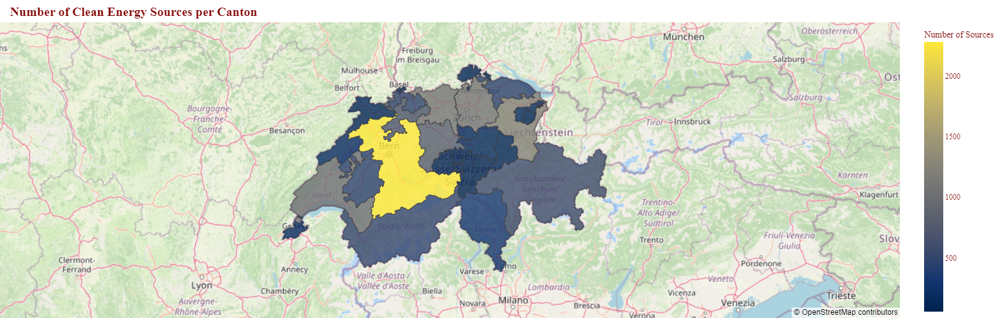

In [23]:
fig = px.choropleth_mapbox(
    sources_per_canton, 
    color="count",
    geojson=cantons, 
    locations="canton_name", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"canton_name":"Canton",
           "count":"Number of Sources"},
    title="<b>Number of Clean Energy Sources per Canton</b>",
    color_continuous_scale="Cividis",
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Sans",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Sans"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )
fig.show()

### Dataset: Dogs of Zurich

In [25]:
# Loading the data - downloaded from here: https://data.stadt-zuerich.ch/dataset/sid_stapo_hundebestand

dogs_of_zurich = pd.read_csv("../data/dogs/20200306_hundehalter.csv")
dogs_of_zurich.head()

,HALTER_ID,ALTER,GESCHLECHT,STADTKREIS,STADTQUARTIER,RASSE1,RASSE1_MISCHLING,RASSE2,RASSE2_MISCHLING,RASSENTYP,GEBURTSJAHR_HUND,GESCHLECHT_HUND,HUNDEFARBE
0,574,61-70,w,2,23,Mischling gross,NaN,NaN,NaN,I,2013,w,schwarz
1,695,41-50,m,6,63,Labrador Retriever,NaN,NaN,NaN,I,2012,w,braun
2,893,71-80,w,7,71,Mittelschnauzer,NaN,NaN,NaN,I,2010,w,schwarz
3,916,41-50,m,3,34,Mischling klein,NaN,NaN,NaN,K,2015,w,hellbraun
4,1177,51-60,m,10,102,Shih Tzu,NaN,NaN,NaN,K,2011,m,schwarz/weiss


In [26]:
# Count the dogs per kreis
dogs_per_kreis = dogs_of_zurich.groupby("STADTKREIS").size().reset_index(name='COUNT')
dogs_per_kreis.head()

,STADTKREIS,COUNT
0,1,123
1,2,738
2,3,697
3,4,410
4,5,258


In [27]:
# Getting the coordinates of the Stadtkreise - file downloaded from here: https://www.stadt-zuerich.ch/geodaten/download/Stadtkreise?format=geojson_link

with open("../data/dogs/stzh.adm_stadtkreise_a.json") as response:
    kreise = json.load(response)

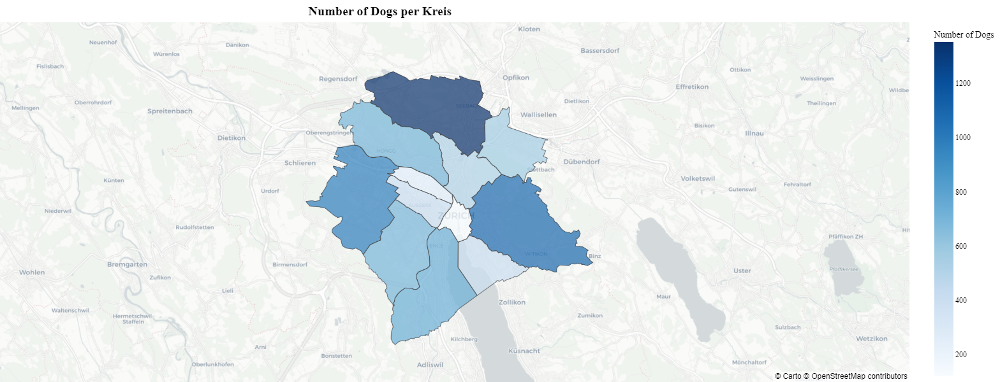

In [28]:
fig = px.choropleth_mapbox(
    dogs_per_kreis, 
    color="COUNT",
    geojson=kreise, 
    locations="STADTKREIS", 
    featureidkey="properties.name",
    center={"lat": 47.38, "lon": 8.54},
    mapbox_style="carto-positron", 
    zoom=10.8,
    opacity=0.7,
    width=700,
    height=600,
    labels={"STADTKREIS":"Kreis",
           "COUNT":"Number of Dogs"},
    title="<b>Number of Dogs per Kreis</b>",
    color_continuous_scale="Blues",
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font_family="Balto",
                  font_color="black",
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Balto"},
                  title={"font_size":20,
                         "xanchor":"center", "x":0.38,
                        "yanchor":"bottom", "y":0.96}
                 )
fig.show()

### Dataset: Volcanoes of the World

In [29]:
# Load the volcano dataset
volcano_df = pd.read_csv('../data/volcano/volcano_ds_pop.csv')

# Load the geoJSON file
with open('../data/volcano/countries.geojson') as file:
    volcano_geojson = json.load(file)

volcano_df.head()

,Unnamed: 0,Number,Volcano Name,Country,Region,Latitude,Longitude,Elev,Type,Status,Last Known,Population (2020)
0,0,0803-001,Abu,Japan,Honshu-Japan,34.500,131.600,571.0,Shield volcano,Holocene,Unknown,126407422.0
1,1,1505-096,Acamarachi,Chile,Chile-N,-23.300,-67.620,6046.0,Stratovolcano,Holocene,Unknown,19144605.0
2,2,1402-08=,Acatenango,Guatemala,Guatemala,14.501,-90.876,3976.0,Stratovolcano,Historical,D1,17971382.0
3,3,0103-004,Acigol-Nevsehir,Turkey,Turkey,38.570,34.520,1689.0,Maar,Holocene,U,84495243.0
4,4,1201-04-,Adams,United States,US-Washington,46.206,-121.490,3742.0,Stratovolcano,Tephrochronology,D6,331341050.0


In [30]:
volcano_df['Country'] = volcano_df['Country'].replace({'United States':'United States of America',
                                                                      'Tanzania':'United Republic of Tanzania',
                                                                      'Martinique':'Martinique',
                                                                      'Sao Tome & Principe':'Sao Tome and Principe',
                                                                      'Guadeloupe':'Guadeloupe',
                                                                      'Wallis & Futuna':'Wallis and Futuna'})

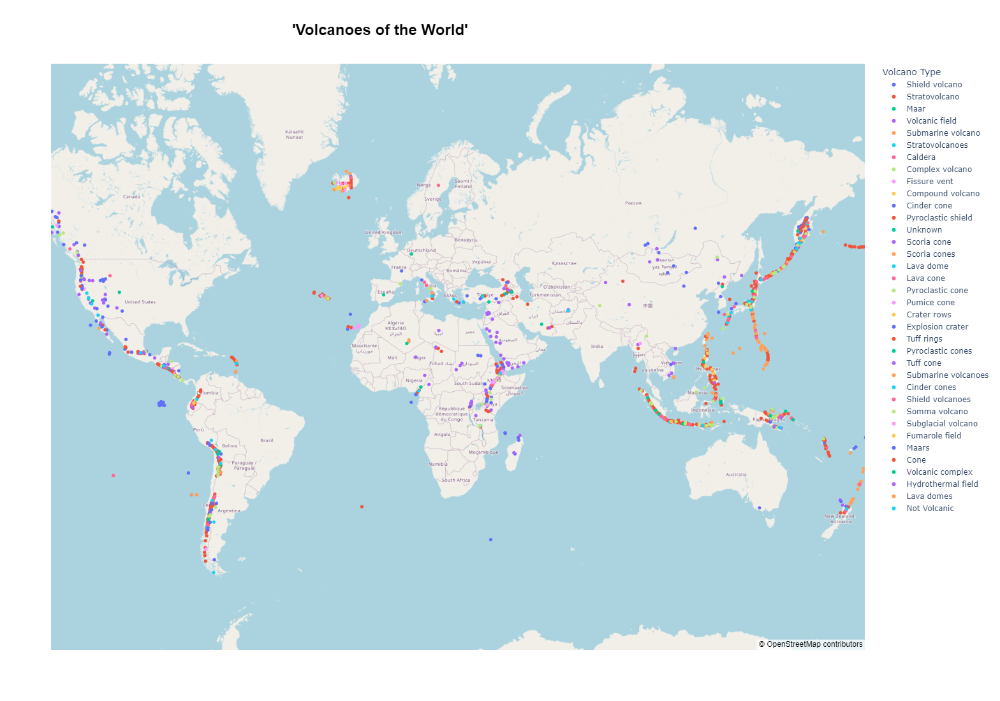

In [31]:
fig = px.scatter_mapbox(volcano_df,
                        lat='Latitude',
                        lon='Longitude',
                        color='Type',
                        hover_name='Volcano Name',
                        hover_data=['Type', 'Country', 'Region', 'Status'],
                        zoom=1.5,
                        title="<b>'Volcanoes of the World'</b>",
                        color_discrete_sequence=px.colors.qualitative.Plotly)

fig.update_layout(
                    title={"font_size":20,
                         "xanchor":"center", "x":0.38,
                        "yanchor":"bottom", "y":0.95},
                    title_font=dict(size=24, color='Black', family='Arial, sans-serif'),
                    height=1100,
                    width=1300,
                    autosize=True,
                    hovermode='closest',
                    mapbox=dict(
                        style='open-street-map'
                    ),
                    legend_title_text='Volcano Type'
)

fig.show()